# Bee wing

Intersection point Notebook on bee wings.

<img src="https://upload.wikimedia.org/wikipedia/commons/8/8e/Bees-wings.web.jpg" width="400" height="200" />


## 0 - Home folder 

In [1]:
# Hereunder you have to define the base path

IMG_FOLDER = "../datas/train/" # FIXME
CSV_FOLDER = "all_csvs"

### Imports

In [2]:
import cv2
import os
from os import listdir
import numpy as np
import matplotlib.pyplot as plt

## 1 - Images loading

In [3]:
def openPathToNpArray(path):
    return np.array(cv2.cvtColor(cv2.imread(path), cv2.COLOR_BGR2RGB))

def getAllImages(basePath):
    trainFiles = listdir(basePath)
    storage = {}
    for elm in trainFiles:
        storage[elm] = openPathToNpArray(basePath + elm)
    return storage

def displayAllImages(allImg): # dictionary of {"imgName" : imgAsNpArray,...}
    for name in allImg:
        showNpArrayAsImage(name, allImg[name])
   
class ImgStorage: # i.e.: storage =  ImgStorage("../datas/train/")
    def __init__(self, basePath):
        self.localMap = getAllImages(basePath)
        self.localList = [(name, self.localMap[name]) for name in self.localMap]
        
    def getImgByIndex(self, index):
        key,value = self.localList[index]
        return value
    
    def getImgNameByIndex(self, index):
        key,value = self.localList[index]
        return key
    
    def getImgByName(self, name):
        return self.localMap[name]
    
    def size(self):
        return len(self.localList)
    
    def showIndex(self, index):
        plt.imshow(self.getImgByIndex(index))        
        
    def showName(self, name):
        plt.imshow(self.getImgByName(name))
        
    def getCSVNameForIndex(self, index):
        return self.getImgNameByIndex(index)[:-4] + ".csv"

In [4]:
allImg = ImgStorage(IMG_FOLDER)

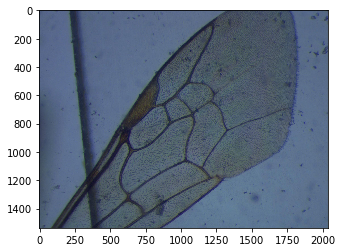

In [5]:
allImg.showIndex(0)

## 2 - Preprocessing

All the functions below are used as preprocessing, you might skip reading this part in order to see preprocessing results directly.

### 2.1 Base code

In [6]:
def kernell(i):
    return np.ones((i,i),np.uint8)

In [7]:
def differenceOfGaussian(img, kernSize1, kernSize2):
    g1 = cv2.blur(img, (kernSize1, kernSize1))
    g2 = cv2.blur(img, (kernSize2, kernSize2))
    return g1 - g2;

In [8]:
def detectEdges(im):
    
    im = cv2.cvtColor(im, cv2.COLOR_RGB2LAB)
    l,a,b = cv2.split(im)
    im = l
    
    im = differenceOfGaussian(im, 25, 30)
    im = cv2.bilateralFilter(im, 10, 50, 75)

    im = cv2.erode(im,kernell(3),iterations = 1)
    im = cv2.dilate(im,kernell(2),iterations = 1)
    
    for i in range(4):
        im = cv2.medianBlur(im, 3)
    
    im = cv2.dilate(im,kernell(3),iterations = 2)
    
    im = cv2.medianBlur(im, 3)
    im = cv2.medianBlur(im, 3)

    return im

In [9]:
def histogram(img):
    maxi = int(np.max(img) + 1)
    img = img.flatten()
    res = np.full((maxi), 0)
    for i in range(len(img)):
        res[int(img[i])] += 1
    return res

In [10]:
# create image to substract (it contains only noise)
def getComplement(img):
    height,width = img.shape
    res = np.full((height, width), 0)
    res = np.array(res, dtype=np.int32)
    histi = histogram(img)
    sortedhisto = np.sort(histi)
    # keep only the 3 biggest parts
    mean = sortedhisto[-3]
    for i in range(height):
        for j in range(width):
            valuee = img[i,j]
            # if pixel is part not part of the 3 biggest parts keep it
            if  histi[valuee] < mean:
                res[i,j]  = 255
            else:
                res[i,j]  = 0
    return res

In [11]:
def postClean(img):
    img = img.astype(np.uint8)
    img = cv2.dilate(img, kernell(4), iterations = 3)
    img = cv2.erode(img, kernell(4), iterations = 3)
    img = cv2.medianBlur(img, 25)
    img = cv2.medianBlur(img, 25)
    return img

In [12]:
def cleanWingImg(img):
    img1 = detectEdges(img)
    _, img2 = cv2.threshold(img1,127, 255,cv2.THRESH_BINARY)
    _, labels = cv2.connectedComponents(img2)
    cppm = getComplement(labels)
    img3 = np.subtract(img2,cppm)
    cleaned = postClean(img3)
    return cleaned

### 2.2 Examples

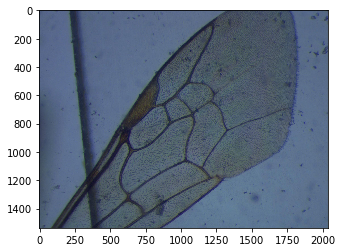

In [13]:
exampleImg = allImg.getImgByIndex(0)
plt.imshow(exampleImg)

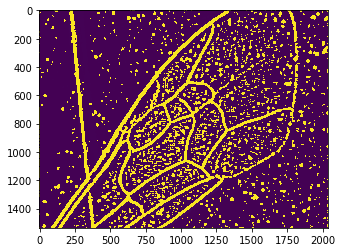

In [14]:
exampleImg1 = detectEdges(exampleImg)
plt.imshow(exampleImg1)

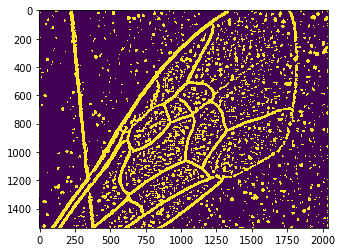

In [15]:
_, exampleImg2 = cv2.threshold(exampleImg1,127, 255,cv2.THRESH_BINARY)
plt.imshow(exampleImg2)

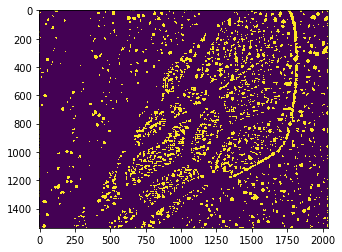

In [16]:
_, labels = cv2.connectedComponents(exampleImg2)
cppm = getComplement(labels)
plt.imshow(cppm)

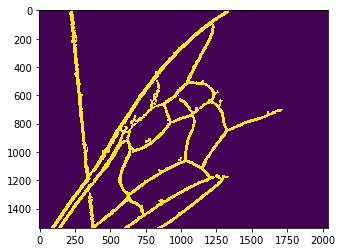

In [17]:
exampleImg3 = np.subtract(exampleImg2,cppm)
plt.imshow(exampleImg3)

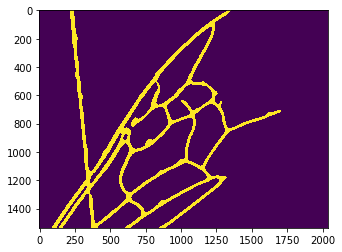

In [18]:
cleaned = postClean(exampleImg3)
plt.imshow(cleaned)

## 3 - Intersections

### 3.1 - Base code

In [19]:
from skimage.morphology import skeletonize

In [20]:
# Show only kernel 3x3 where number of pixel != 0 is greater or equal to 4
def keepGT4(im):
    img = (im > 0) * 1
    res = np.full(img.shape,0)
    height, width = img.shape
    for i in range(height):
        for j in range(width):
            minx = max(0, i - 1)
            maxx = min(height - 1, i + 1)
            miny = max(0, j - 1)
            maxy = min(width - 1, j + 1)
            subimg = img[minx:maxx + 1,miny:maxy + 1]
            ss = np.sum(subimg)
            res[i,j] = 255 if ss >= 4 else 0
    return res.astype(np.uint8)

In [21]:
# keep centroids of connected components
def imageDotsToCentroidList(img):
    im = cv2.dilate(img,kernell(5),iterations = 5)
    nb_components, output, stats, centroids = cv2.connectedComponentsWithStats(im, connectivity=8)
    return centroids

In [22]:
def imgToCentroidList(img, verbose=True):
    if(verbose):
        print("Cleaning image...")
    cleanedImg = cleanWingImg(img)
    if(verbose):
        print("computing skeleton...")
    cleanedImg = cleanedImg / 255
    skell = skeletonize(cleanedImg)
    if(verbose):
        print("keeping centroids...")
    dotsImg = keepGT4(skell)
    if(verbose):
        print("Computing centroids...")
    centroidList = imageDotsToCentroidList(dotsImg)
    if(verbose):
        print("Writing to file...")
    centroidList = np.flip(centroidList,axis= 1)
    if(verbose):
        print("Done.")
    return centroidList

### 3.2 - Example

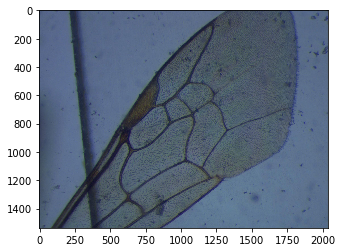

In [23]:
exampleImg = allImg.getImgByIndex(0)
plt.imshow(exampleImg)

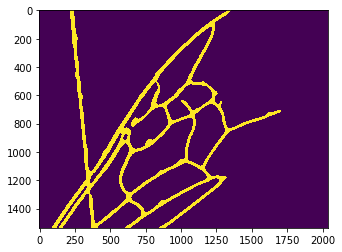

In [24]:
cleanedImg = cleanWingImg(exampleImg)
plt.imshow(cleanedImg)

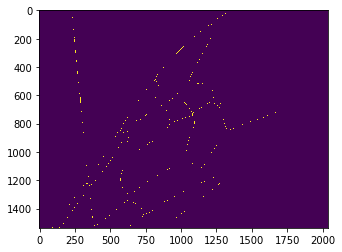

In [25]:
cleanedImg = cleanedImg / 255
skell = skeletonize(cleanedImg)
plt.imshow(skell)

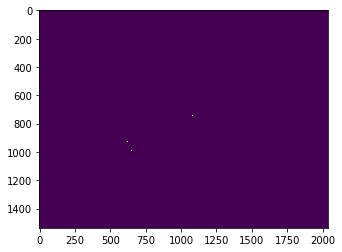

In [26]:
dotsImg = keepGT4(skell)
plt.imshow(dotsImg)

In [27]:
centroidList = imageDotsToCentroidList(dotsImg)
centroidList = np.flip(centroidList, axis=1)
print(centroidList.shape)
centroidList[:5]

(31, 2)


array([[ 766.78737655, 1019.91088058],
       [  77.        , 1236.        ],
       [ 100.52173913, 1220.52173913],
       [ 497.02539299,  812.65659008],
       [ 507.52079208, 1059.02178218]])

## 4 - Colorize

### 4.1 - Base code

In [28]:
import csv
import PIL
from PIL import Image, ImageDraw
from numpy import loadtxt, array

In [29]:
def draw_intersections(image, intersections, width):
    image = PIL.Image.fromarray(image)
    draw = ImageDraw.Draw(image)
    for x, y in intersections:
        draw.ellipse((y - width, x - width, y + width, x + width), fill=(255, 0, 0))
    return image

In [30]:
def generateResultImage(imagePath, csvPath, outputPath):
    image = Image.open(imagePath)
    coords = loadtxt(csvPath, delimiter=',')
    if len(coords.shape) != 2:
        coords = array([coords])
    draw_intersections(image, coords)
    image.save(output_path)

### 4.2 - Example

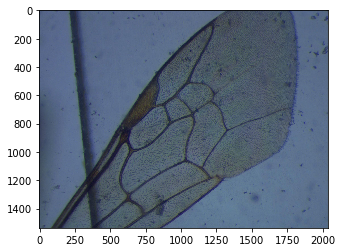

In [31]:
exampleImg = allImg.getImgByIndex(0)
plt.imshow(exampleImg)

In [32]:
centroids = imgToCentroidList(exampleImg)
centroids[:5]

Cleaning image...
computing skeleton...
keeping centroids...
Computing centroids...
Writing to file...
Done.


array([[ 766.78737655, 1019.91088058],
       [  77.        , 1236.        ],
       [ 100.52173913, 1220.52173913],
       [ 497.02539299,  812.65659008],
       [ 507.52079208, 1059.02178218]])

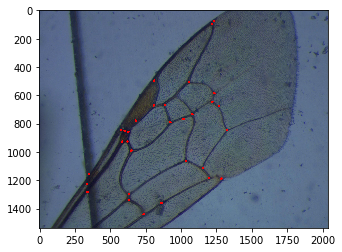

In [33]:
redDotsImg = draw_intersections(exampleImg, centroids, 8)
plt.imshow(redDotsImg)

## 5 - Process all image from imput folder 

### 5.1 - Base code

Here's some multiprocessed code to generate intersection csv.

In [73]:
def worker(folder,index, imgStorage, size):
    if index >= size:
        return
    im = imgStorage.getImgByIndex(index)
    centroids =  imgToCentroidList(im, verbose=False)
    #centroids = np.flip(centroids, axis=1)
    csvPath = imgStorage.getCSVNameForIndex(index)
    #print(csvPath)
    np.savetxt(folder + csvPath, centroids, delimiter=",")
    print(index+1, "/", imgStorage.size(), ": ",csvPath ," written.")
        

In [74]:
import multiprocessing

def generateAllCsv(imgStorage, processNumber):
    folder = CSV_FOLDER
    if folder[-1] != "/":
            folder = folder + "/"
    if not os.path.exists(folder):
        os.makedirs(folder)
    currIndex = 0
    while currIndex < imgStorage.size():
        processList = []
        for i in range(processNumber):
            p = multiprocessing.Process(target=worker, args=(folder,currIndex + i, imgStorage, imgStorage.size()))
            processList.append(p)
            p.start()

        for process in processList:
            process.join()
        currIndex += processNumber
    
    print("Done.")

### 5.2 - CSV file generation

In [75]:
%time
# You might change the process number according to your thread number
generateAllCsv(allImg, 9)

CPU times: user 16 µs, sys: 0 ns, total: 16 µs
Wall time: 31.7 µs
3 / 32 :  154 Lasioglossum nymphaerum f right 4x.csv  written.
4 / 32 :  85 Lasioglossum rohweri f right 4x.csv  written.
6 / 32 :  1165 Agapostemon texanus f left 3.2x.csv  written.
7 / 32 :  149 Lasioglossum rohweri f left 4x.csv  written.
2 / 32 :  1 Lasioglossum leucozonium f right 3.2x.csv  written.
9 / 32 :  119 Lasioglossum rohweri f left 4x.csv  written.
5 / 32 :  84 Lasioglossum MAWIspB f left 4x.csv  written.
1 / 32 :  173 Lasioglossum rohweri f left 4x.csv  written.
8 / 32 :  913 Lasioglossum leucozonium f left 3.2x.csv  written.
14 / 32 :  87 Lasioglossum pilosum f left 4x.csv  written.
11 / 32 :  41 Lasioglossum rohweri f right 4x.csv  written.
13 / 32 :  784 Lasioglossum zonulum f left 4x.csv  written.
15 / 32 :  842 Agapostemon texanus f right 3.2x.csv  written.
16 / 32 :  7 Lasioglossum leucozonium f left 3.2x.csv  written.
10 / 32 :  133 Lasioglossum nymphaerum f left 4x.csv  written.
18 / 32 :  112 Lasi

## 6 - Show all images with dots at intersection

### 6.1 - Base code

In [88]:
def allPlot():
    imgNB = allImg.size()
    csv_path = CSV_FOLDER
    if csv_path[-1] != "/":
            csv_path = csv_path + "/"
    if not os.path.exists(csv_path):
        os.makedirs(csv_path)
    fig, axes = plt.subplots(imgNB // 2, 2, figsize=(30, 200))
    for i in range(imgNB):
        path = csv_path + allImg.getCSVNameForIndex(i)
        img = allImg.getImgByIndex(i)
        coords = loadtxt(path, delimiter=',')
        if len(coords.shape) != 2:
            coords = array([coords])
        resultt = draw_intersections(img, coords, 8)
        axes[i // 2, i % 2].imshow(resultt)
    plt.show()

### 6.2 - Results

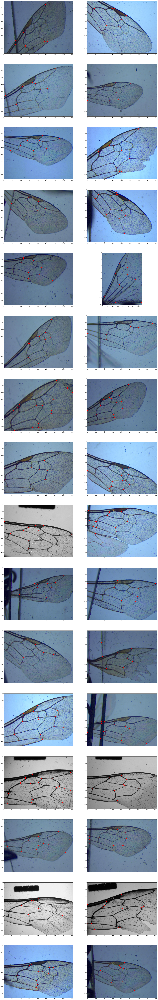

In [89]:
allPlot()